In [1]:
import numpy as np
from datasets import load_dataset

data = load_dataset(
    "jamescalam/image-text-demo",
    split="train",
    revision="180fdae"
)


/home/ming/dev/transformers/.venv/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Found cached dataset image-text-demo (/home/ming/.cache/huggingface/datasets/jamescalam___image-text-demo/default/0.0.0/83e33802f1af183872ab59b5bf8b7ae25968f4e294f8529fdae035f54b9a5abc)


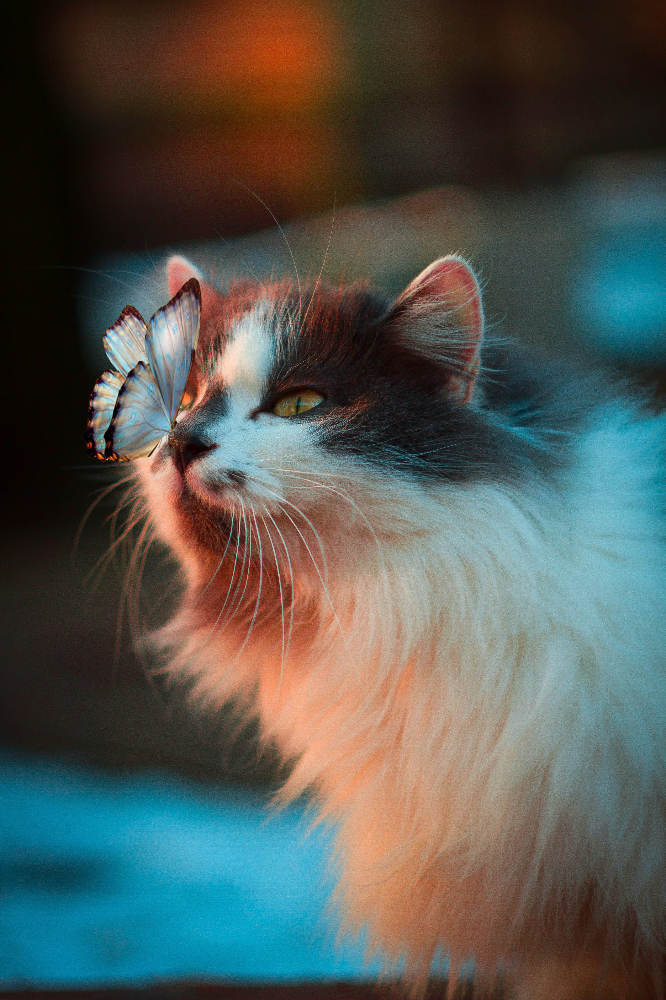

In [2]:
data[2]['image']

In [4]:
from transformers import CLIPProcessor, CLIPModel
import torch

# define processor and model
model_id = "openai/clip-vit-base-patch32"

processor = CLIPProcessor.from_pretrained(model_id)
model = CLIPModel.from_pretrained(model_id)

# move model to device if possible
device = 'cuda' if torch.cuda.is_available() else 'cpu'

model.to(device)

CLIPModel(
  (text_model): CLIPTextTransformer(
    (embeddings): CLIPTextEmbeddings(
      (token_embedding): Embedding(49408, 512)
      (position_embedding): Embedding(77, 512)
    )
    (encoder): CLIPEncoder(
      (layers): ModuleList(
        (0-11): 12 x CLIPEncoderLayer(
          (self_attn): CLIPAttention(
            (k_proj): Linear(in_features=512, out_features=512, bias=True)
            (v_proj): Linear(in_features=512, out_features=512, bias=True)
            (q_proj): Linear(in_features=512, out_features=512, bias=True)
            (out_proj): Linear(in_features=512, out_features=512, bias=True)
          )
          (layer_norm1): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
          (mlp): CLIPMLP(
            (activation_fn): QuickGELUActivation()
            (fc1): Linear(in_features=512, out_features=2048, bias=True)
            (fc2): Linear(in_features=2048, out_features=512, bias=True)
          )
          (layer_norm2): LayerNorm((512,), eps=1e-05,

In [9]:
from tqdm.auto import tqdm
import torch
from transformers import CLIPProcessor, CLIPModel
import matplotlib.patches as matplot_patches
import matplotlib.pyplot as plt
patch = 256

colors = ['#FAFF00', '#8CF1FF']

def get_patches(img, patch_size=256):
    # add extra dimension for later calculations
    img_patches = img.data.unfold(0,3,3)
    # break the image into patches (in height dimension)
    img_patches = img_patches.unfold(1, patch_size, patch_size)
    # break the image into patches (in width dimension)
    img_patches = img_patches.unfold(2, patch_size, patch_size)
    return img_patches

def get_scores(img_patches, prompt, window=6, stride=1):
    # initialize scores and runs arrays
    scores = torch.zeros(img_patches.shape[1], img_patches.shape[2])
    runs = torch.ones(img_patches.shape[1], img_patches.shape[2])

    # iterate through patches
    for Y in range(0, img_patches.shape[1]-window+1, stride):
        for X in range(0, img_patches.shape[2]-window+1, stride):
            # initialize array to store big patches
            big_patch = torch.zeros(patch*window, patch*window, 3)
            # get a single big patch
            patch_batch = img_patches[0, Y:Y+window, X:X+window]
            # iteratively build all big patches
            for y in range(window):
                for x in range(window):
                    big_patch[y*patch:(y+1)*patch, x*patch:(x+1)*patch, :] = patch_batch[y, x].permute(1, 2, 0)
            inputs = processor(
                images=big_patch, # image trasmitted to the model
                return_tensors="pt", # return pytorch tensor
                text=prompt, # text trasmitted to the model
                padding=True
            ).to(device) # move to device if possible

            score = model(**inputs).logits_per_image.item()
            # sum up similarity scores
            scores[Y:Y+window, X:X+window] += score
            # calculate the number of runs 
            runs[Y:Y+window, X:X+window] += 1
    # calculate average scores
    scores /= runs
    # clip scores
    for _ in range(3):
        scores = np.clip(scores-scores.mean(), 0, np.inf)
    # normalize scores
    scores = (scores - scores.min()) / (scores.max() - scores.min())
    return scores

def get_box(scores, patch_size=256, threshold=0.5):
    detection = scores > threshold
    # find box corners
    y_min, y_max = np.nonzero(detection)[:,0].min().item(), np.nonzero(detection)[:,0].max().item()+1
    x_min, x_max = np.nonzero(detection)[:,1].min().item(), np.nonzero(detection)[:,1].max().item()+1
    # convert from patch co-ords to pixel co-ords
    y_min *= patch_size
    y_max *= patch_size
    x_min *= patch_size
    x_max *= patch_size
    # calculate box height and width
    height = y_max - y_min
    width = x_max - x_min
    return x_min, y_min, width, height

def detect(prompts, img, patch_size=256, window=6, stride=1, threshold=0.5):
    X = 13
    Y = 20
    # build image patches for detection
    img_patches = get_patches(img, patch_size)
    # convert image to format for displaying with matplotlib
    image = np.moveaxis(img.data.numpy(), 0, -1)
    # initialize plot to display image + bounding boxes
    fig, ax = plt.subplots(figsize=(Y*0.5, X*0.5))
    ax.imshow(image)
    # process image through object detection steps
    for i, prompt in enumerate(tqdm(prompts)):
        scores = get_scores(img_patches, prompt, window, stride)
        x, y, width, height = get_box(scores, patch_size, threshold)
        # create the bounding box
        rect = matplot_patches.Rectangle((x, y), width, height, linewidth=3, edgecolor=colors[i], facecolor='none')
        # add the patch to the Axes
        ax.add_patch(rect)
    plt.show()

In [12]:
from torchvision import transforms

# transform the image into tensor
transt = transforms.ToTensor()

img = transt(data[2]["image"])
img.data.shape

detect(["a butterfly"], img, window=4, stride=1)

100%|██████████| 1/1 [05:00<00:00, 300.82s/it]


KeyboardInterrupt: 